In [1]:
import matplotlib.pyplot as plt
import librosa
import numpy as np
import scipy.signal as signal

1. Execute análise tempo-frequência utilizando STFT e janelas da ordem de 30 ms.

### Read File


In [2]:
data, fs = librosa.load("audio.mp3")

In [3]:
len(data) / fs  # duration in seconds: 1min 46s

106.08326530612244

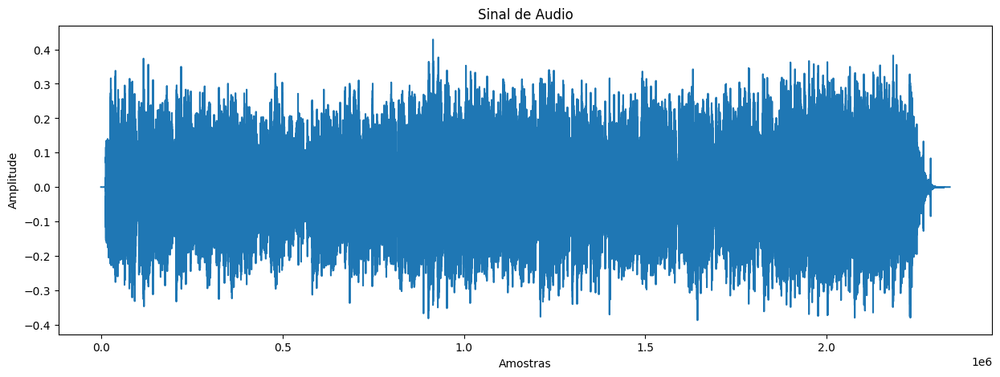

In [4]:
plt.figure(figsize=(15, 5))
plt.plot(data)
plt.title("Sinal de Audio")
plt.xlabel("Amostras")
plt.ylabel("Amplitude")
plt.show()

### Cut file


In [5]:
size_in_seconds = 60
size_in_samples = size_in_seconds * fs

In [6]:
data = data[:size_in_samples]

### STFFT


#### Janela


In [7]:
fs

22050

In [8]:
T = 30e-3
window_size = int(T * fs)
hop_size = window_size // 2
janela = signal.windows.hamming(window_size)

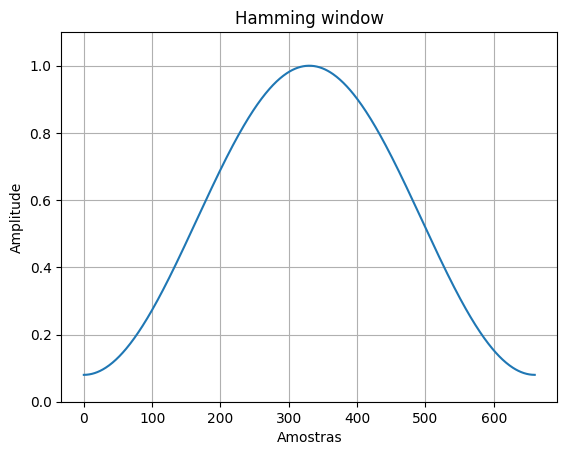

In [9]:
plt.plot(janela)
plt.title("Hamming window")
plt.xlabel("Amostras")
plt.ylabel("Amplitude")
plt.ylim(0, 1.1)
plt.grid()
plt.show()

In [10]:
SFT = signal.ShortTimeFFT(
    win=janela,
    hop=hop_size,
    fs=fs,
    # mfft=mfft,
)

In [11]:
stft_data = SFT.spectrogram(data)
signal_info = SFT.extent(len(data))

In [12]:
def plot_spectrogram(data, signal_info, title="Spectrogram (dB)", ax=None):
    t_min, t_max, f_min, f_max = signal_info
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 7))
    im = ax.imshow(
        10 * np.log10(data.T + 1e-6),
        aspect="auto",
        origin="lower",
        cmap="jet",
        extent=(f_min, f_max, t_min, t_max),
    )
    plt.colorbar(im, ax=ax, label="Magnitude (dB)")
    ax.set_title(title)
    ax.set_ylabel("Time (s)")
    ax.set_xlabel("Frequency bins")

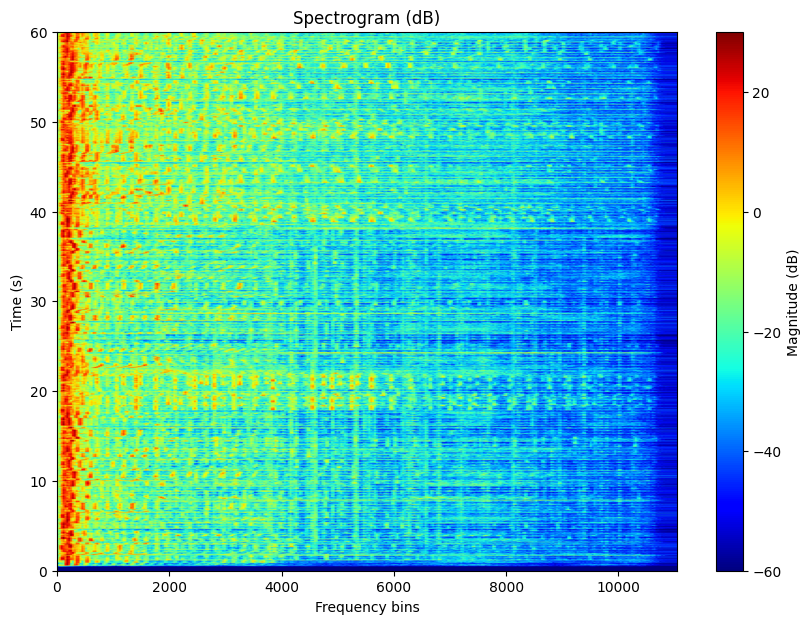

In [13]:
plot_spectrogram(data=stft_data, signal_info=signal_info)

a) Tipos de Janelas diferentes: Hamming e Triangular

###

In [14]:
T = 30e-3
window_size = int(T * fs)
hop_size = window_size // 2

In [15]:
janela_hamming = signal.windows.hamming(window_size)
janela_triangular = signal.windows.boxcar(window_size)

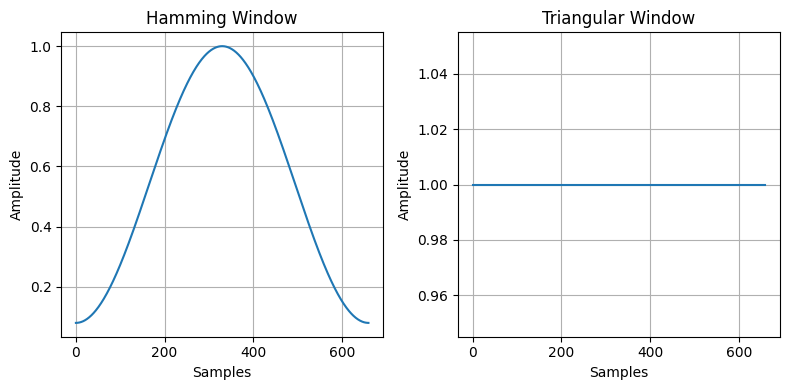

In [16]:
fig, ax = plt.subplots(1, 2, figsize=(8, 4))
ax[0].plot(janela_hamming)
ax[1].plot(janela_triangular)
ax[0].set_title("Hamming Window")
ax[1].set_title("Triangular Window")

for ax_ in ax:
    ax_.set_xlabel("Samples")
    ax_.set_ylabel("Amplitude")
    ax_.grid()

plt.tight_layout()
plt.show()

In [17]:
stft_hamming = signal.ShortTimeFFT(win=janela_hamming, hop=hop_size, fs=fs)
stft_triangular = signal.ShortTimeFFT(win=janela_triangular, hop=hop_size, fs=fs)

stft_data_hamming = stft_hamming.spectrogram(data)
signal_info_hamming = stft_hamming.extent(len(data))

stft_data_triangular = stft_triangular.spectrogram(data)
signal_info_triangular = stft_triangular.extent(len(data))

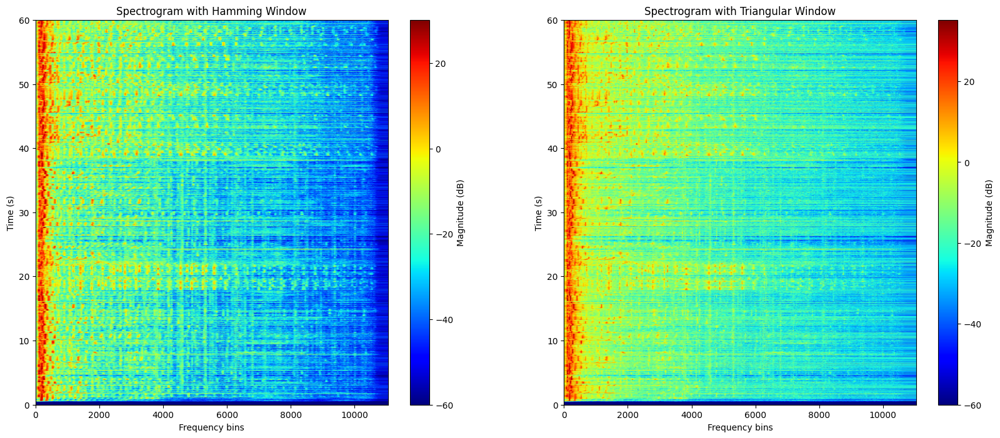

In [18]:
fig, ax = plt.subplots(1, 2, figsize=(20, 8))
plot_spectrogram(
    data=stft_data_hamming,
    signal_info=signal_info_hamming,
    title="Spectrogram with Hamming Window",
    ax=ax[0],
)
plot_spectrogram(
    data=stft_data_triangular,
    signal_info=signal_info_triangular,
    title="Spectrogram with Triangular Window",
    ax=ax[1],
)

Pode-se notar que o sinal com a janela retangular ou boxcar apresenta um maior espalhamento nas frequências, resultando em uma falta de definição dos componentes de frequência do sinal. <br>

b) Variação entre o intervalo de tempo entre janelas adjacentes (hop_size)

Em teoria, ao aumentar o tamanho do intervalo de tempo entre as janelas adjacentes, você irá causar um efeito de suavização entre as transições do espectrograma. <br>
Isso ocorre pelo fato do conteúdo de uma determinada janela não diferir tanto da seguinte. <br>
No caso contrário, supondo um hop-size nulo — sem sobreposição entre janelas adjacentes —, o conteúdo de frequência pode diferir significativamente. 

In [19]:
window_size // 4

165

In [20]:
T = 30e-3
window_size = int(T * fs)
hop_size = int(window_size // 0.1)
janela = signal.windows.hamming(window_size)

In [21]:
stft_hamming_hop90 = signal.ShortTimeFFT(win=janela, hop=hop_size, fs=fs)
stft_data_hamming_hop90 = stft_hamming_hop90.spectrogram(data)
signal_info_hamming_hop90 = stft_hamming_hop90.extent(len(data))

stft_hamming_hop0 = signal.ShortTimeFFT(win=janela, hop=window_size, fs=fs)
stft_data_hamming_hop0 = stft_hamming_hop0.spectrogram(data)
signal_info_hamming_hop0 = stft_hamming_hop0.extent(len(data))

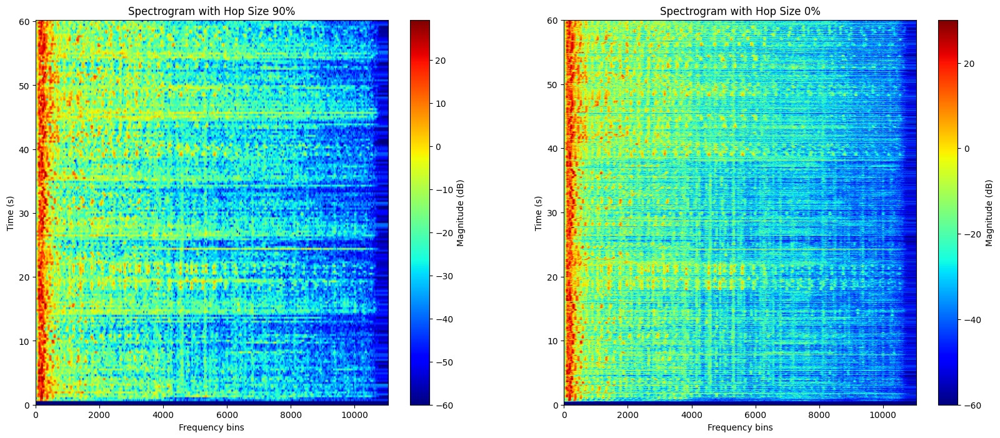

In [22]:
fig, ax = plt.subplots(1, 2, figsize=(20, 8))
plot_spectrogram(
    data=stft_data_hamming_hop90,
    signal_info=signal_info_hamming_hop90,
    title="Spectrogram with Hop Size 90%",
    ax=ax[0],
)
plot_spectrogram(
    data=stft_data_hamming_hop0,
    signal_info=signal_info_hamming_hop0,
    title="Spectrogram with Hop Size 0%",
    ax=ax[1],
)

2. Varie a largura da janela entre 10 e 100 ms, observe e comente as diferenças entre os espectrogramas obtidos.

In [23]:
interval = np.arange(10e-3, 101e-3, 10e-3)
interval

array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ])

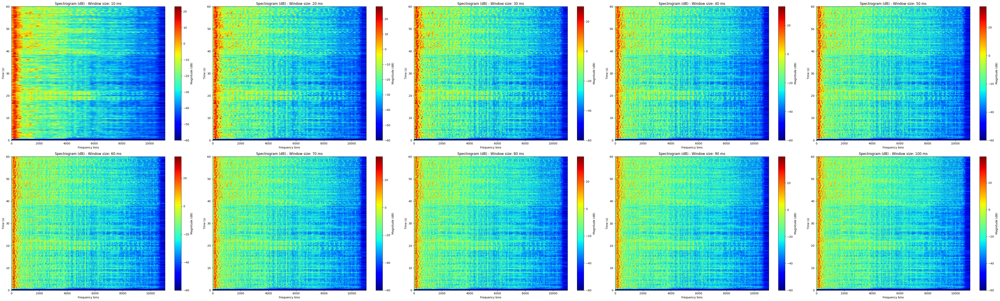

In [24]:
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(50, 15))

for windows_size_time, ax_ in zip(interval, ax.flatten()):
    window_size = int(windows_size_time * fs)
    hop_size = window_size // 2
    janela = signal.windows.hamming(window_size)
    title = f"Spectrogram (dB) - Window size: {windows_size_time*1e3:.0f} ms"
    SFT = signal.ShortTimeFFT(
        win=janela,
        fs=fs,
        hop=hop_size,
        # mfft=mfft,
    )

    stft_data = SFT.spectrogram(data)
    signal_info = SFT.extent(len(data))
    plot_spectrogram(stft_data, signal_info=signal_info, title=title, ax=ax_)
plt.tight_layout()

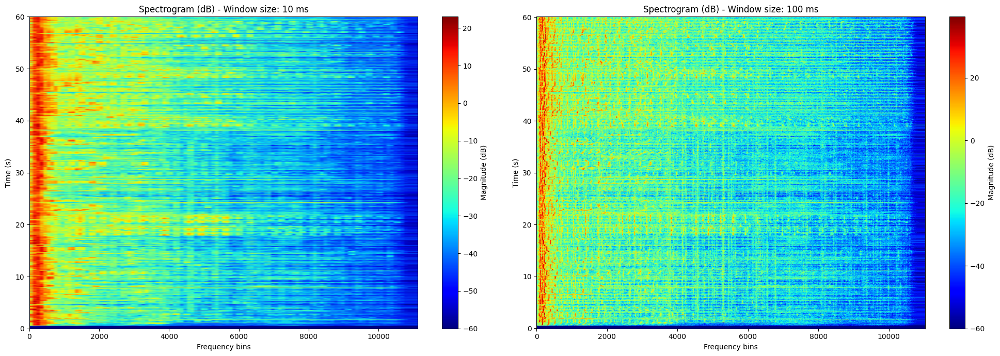

In [25]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 7))

for windows_size_time, ax_ in zip([0.01, 0.1], ax.flatten()):
    window_size = int(windows_size_time * fs)
    hop_size = window_size // 2
    janela = signal.windows.hamming(window_size)
    title = f"Spectrogram (dB) - Window size: {windows_size_time*1e3:.0f} ms"
    SFT = signal.ShortTimeFFT(
        win=janela,
        fs=fs,
        hop=hop_size,
        # mfft=mfft,
    )

    stft_data = SFT.spectrogram(data)
    signal_info = SFT.extent(len(data))
    plot_spectrogram(stft_data, signal_info=signal_info, title=title, ax=ax_)
plt.tight_layout()

A técnica da STFT apresenta uma limitação, em função da sua resolução fixa, que pode ser observada nessas duas imagens. <br>
Com uma janela mais curta, é possível identificar com mais nitidez as variações no eixo y correspondente ao tempo. Em contraponto, as frequências parecem misturadas, sem uma definição razoável. <br>
Ao aumentar a janela para 100ms, analisamos por transformada um intervalo considerável do sinal, o que resulta em maior detalhamento nas faixas de frequência obtidas. <br>
Por outro lado, a separação temporal entre eventos acaba sendo prejudicada. <br>
Tal análise corrobora o tradeoff inerente à técnica da STFT, não sendo possível obter, simultaneamente, uma boa resolução temporal e de frequência.